In [1]:
import json
import os
import cv2
import numpy as np
from ultralytics import YOLO
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

In [2]:
class_names_json_path = "./dataset/img-to-text/class-list.json"

model_1_path = "./Image to Number Plate Detection/train_YOLOv12_32/weights/best.pt"
model_2_path = "./num_plate/train_YOLO12_evenv_/weights/best.pt"

model_1 = YOLO(model_1_path)
model_2 = YOLO(model_2_path)

In [3]:
# Load Bengali font
bangla_font_path = './fonts/NotoSansBengali-Light.ttf'
try:
    pil_font = ImageFont.truetype(bangla_font_path, 20)
    print("Bangla font loaded successfully.")
except:
    pil_font = ImageFont.load_default()
    print("WARNING: Could not load Bangla font. Text may not display correctly.")

Bangla font loaded successfully.


In [4]:
class_names = []
def load_class_names(json_path):
    global class_names
    with open(json_path, "r", encoding="utf-8") as f:
        data = json.load(f)

    class_names = [data[str(i)] for i in range(len(data))]

load_class_names(class_names_json_path)
print("Class names loaded:", class_names)

Class names loaded: ['০', '১', '২', '৩', '৪', '৫', '৬', '৭', '৮', '৯', 'মেট্রো', 'অ', 'ভ', 'চ', 'ছ', 'ড', 'দ', 'এ', 'গ', 'ঘ', 'হ', 'জ', 'ঝ', 'ক', 'খ', 'ল', 'ম', 'ন', 'প', 'স', 'শ', 'ট', 'ঠ', 'থ', 'উ', 'বাগেরহাট', 'বগুড়া', 'বান্দরবান', 'বরগুনা', 'বরিশাল', 'ভোলা', 'ব্রাহ্মণবাড়িয়া', 'চাঁদপুর', 'চাপাইনবাবগঞ্জ', 'চট্ট', 'চট্টগ্রাম', 'চুয়াডাঙ্গা', 'কক্সবাজার', 'কুমিল্লা', 'ঢাকা', 'দিনাজপুর', 'ফরিদপুর', 'ফেনী', 'গাইবান্ধা', 'গাজীপুর', 'গোপালগঞ্জ', 'হবিগঞ্জ', 'জামালপুর', 'যশোর', 'ঝালকাঠি', 'ঝিনাইদহ', 'জয়পুরহাট', 'খাগড়াছড়ি', 'খুলনা', 'কিশোরগঞ্জ', 'কুড়িগ্রাম', 'কুষ্টিয়া', 'লক্ষ্মীপুর', 'লালমনিরহাট', 'মাদারিপুর', 'মাগুরা', 'মানিকগঞ্জ', 'মেহেরপুর', 'মৌলভীবাজার', 'ময়মনসিংহ', 'নওগাঁ', 'নারাইল', 'নারায়ণগঞ্জ', 'নরসিংদী', 'নাটোর', 'নেত্রকোণা', 'নীলফামারি', 'নোয়াখালী', 'পাবনা', 'পঞ্চগড়', 'পটুয়াখালি', 'পিরোজপুর', 'রাজ', 'রাজবাড়ী', 'রাজশাহী', 'রাঙ্গামাটি', 'রংপুর', 'সাতক্ষীরা', 'শরিয়তপুর', 'শেরপুর', 'সিরাজগঞ্জ', 'সুনামগঞ্জ', 'সিলেট', 'টাঙ্গাইল', 'ঠাকুরগাঁও', 'ঢ', 'ব']


In [5]:
def id_to_text(class_id):
    if class_id is not None:
        return str(class_names[class_id])
    else: 
        return ""

In [6]:
def detect_object(image, model):
    results = model(image, verbose=False)
    dets = results[0].boxes

    output = []
    for box in dets:
        cls = int(box.cls.cpu().numpy().item())
        conf = float(box.conf.cpu().numpy().item())

        x1, y1, x2, y2 = box.xyxy.cpu().numpy()[0]

        output.append({
            "class_id": cls,
            "confidence": conf,
            "x1": float(x1),
            "y1": float(y1),
            "x2": float(x2),
            "y2": float(y2)
        })

    return output

In [7]:
def organize_label(detections):
    car_number_class_array = []
    car_area_class = None
    car_metro_class = None
    car_letter_class = None

    for det in detections:
        class_id = det["class_id"]
        conf = det.get("confidence", 0.0)
        x1 = det.get("x1", 0)

        if 0 <= class_id <= 9:
            car_number_class_array.append({
                "class_id": class_id,
                "x1": x1,
                "confidence": conf
            })
        elif class_id == 10:
            if (car_metro_class is None) or (conf > car_metro_class["confidence"]):
                car_metro_class = {"class_id": class_id, "confidence": conf}
        elif (11 <= class_id <= 34) or (100 <= class_id <= 101):
            if (car_letter_class is None) or (conf > car_letter_class["confidence"]):
                car_letter_class = {"class_id": class_id, "confidence": conf}
        else:
            if (car_area_class is None) or (conf > car_area_class["confidence"]):
                car_area_class = {"class_id": class_id, "confidence": conf}

    # keep only the top 6 numbers by confidence
    car_number_class_array = sorted(
        car_number_class_array,
        key=lambda d: d["confidence"],
        reverse=True
    )[:6]

    # then sort left->right
    car_number_class_array.sort(key=lambda d: d["x1"])

    car_number = "".join(id_to_text(item["class_id"]) for item in car_number_class_array)
    car_number = car_number[:2] + "-" + car_number[2:]
    car_area = id_to_text(car_area_class["class_id"]) if car_area_class else ""
    car_metro = id_to_text(car_metro_class["class_id"]) if car_metro_class else ""
    car_letter = id_to_text(car_letter_class["class_id"]) if car_letter_class else ""

    parts = [p for p in (car_area, car_metro, car_letter) if p]
    complete_num_plate_text = "-".join(parts) + "\n" + car_number

    return complete_num_plate_text


In [8]:
def draw_annotations(image, detections, label_texts):
    """
    image: original OpenCV BGR image
    detections: array from detect_object (each item contains x1,y1,x2,y2,...)
    label_texts: array of strings (same length as detections)
    """

    # Convert BGR → RGB for PIL
    pil_image = Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    draw = ImageDraw.Draw(pil_image)

    # Basic color for bounding boxes
    box_color = (0, 255, 0)       # Green
    text_bg_color = (52, 25, 48)
    text_color    = (0, 255, 0)

    # Loop through detections + corresponding label
    for det, text in zip(detections, label_texts):
        x1 = int(det["x1"])
        y1 = int(det["y1"])
        x2 = int(det["x2"])
        y2 = int(det["y2"])

        # Draw bounding box
        draw.rectangle([(x1, y1), (x2, y2)], outline=box_color, width=3)

        # Calculate text size
        text_bbox = draw.textbbox((0, 0), text, font=pil_font)
        tw = text_bbox[2] - text_bbox[0]
        th = text_bbox[3] - text_bbox[1]

        # Background rectangle for text
        draw.rectangle([(x1, y1 - th - 6), (x1 + tw + 6, y1)], fill=text_bg_color)

        # Draw the text
        draw.text((x1 + 3, y1 - th - 3), text, font=pil_font, fill=text_color)

    # Convert back to BGR for OpenCV
    result_img = cv2.cvtColor(np.array(pil_image), cv2.COLOR_RGB2BGR)
    return result_img

In [15]:
%matplotlib inline

def complete_numplate_detection(image):
    
    print("\n____________________________________________________________")
    print("Processing image for number plate detection...")


    global model_1, model_2
    
    numplate_positions = detect_object(image, model_1)
    numplate_labels = []

    h, w = image.shape[:2]

    for det in numplate_positions:
        x1 = max(0, min(int(det["x1"]), w - 1))
        y1 = max(0, min(int(det["y1"]), h - 1))
        x2 = max(0, min(int(det["x2"]), w - 1))
        y2 = max(0, min(int(det["y2"]), h - 1))

        if x2 <= x1 or y2 <= y1:
            numplate_labels.append("")
            continue

        crop = image[y1:y2, x1:x2]
        text_detections = detect_object(crop, model_2)

        # Convert detections into readable Bengali plate string
        plate_text = organize_label(text_detections)
        print("\nDetected Plate Text:", plate_text.replace("\n", " "))
        numplate_labels.append(plate_text)

    # 3) Draw annotations on the original image
    annotated = draw_annotations(image, numplate_positions, numplate_labels)
    annotated_display = cv2.cvtColor(annotated, cv2.COLOR_BGR2RGB)
    fig, axes = plt.subplots(1, 1, figsize=(10, 10))
    # axes[0].imshow(annotated)
    # axes[0].set_title(f'Original Image with Ground Truth Labels\n({img_filename})')
    # axes[0].axis('off')

    axes.imshow(annotated_display)
    axes.set_title(f'Predicted Detections')
    axes.axis('off')

    plt.tight_layout()
    plt.show()


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-গ ২৯-৩৫৯২


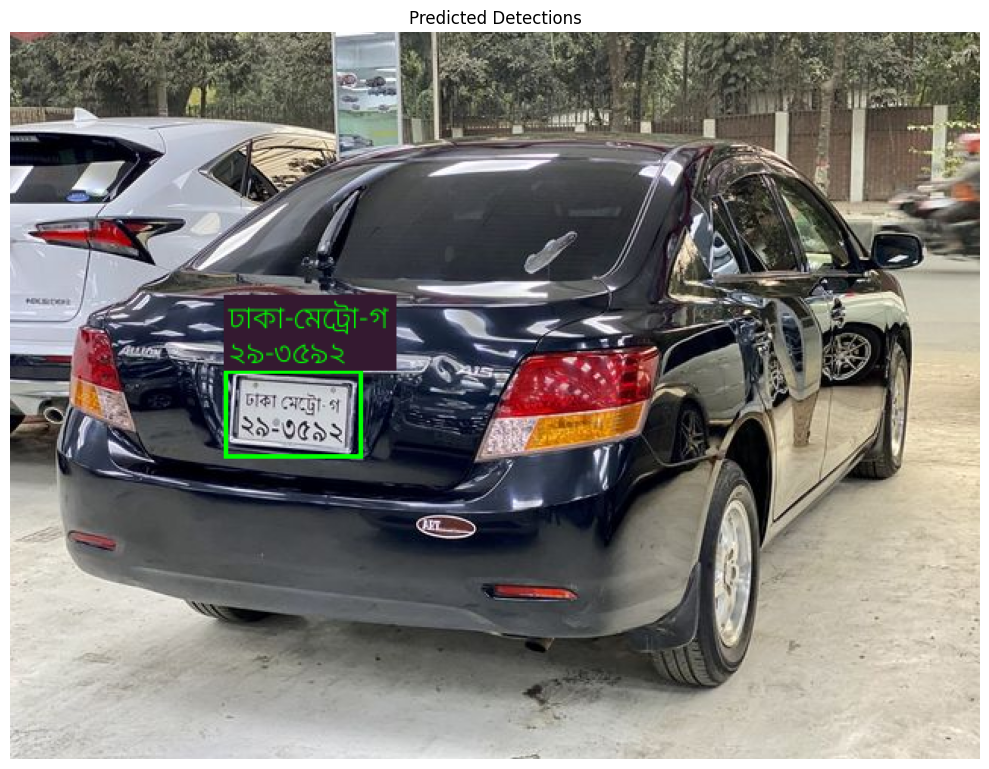


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: চট্ট-মেট্রো-গ ১৩-০২৩৬


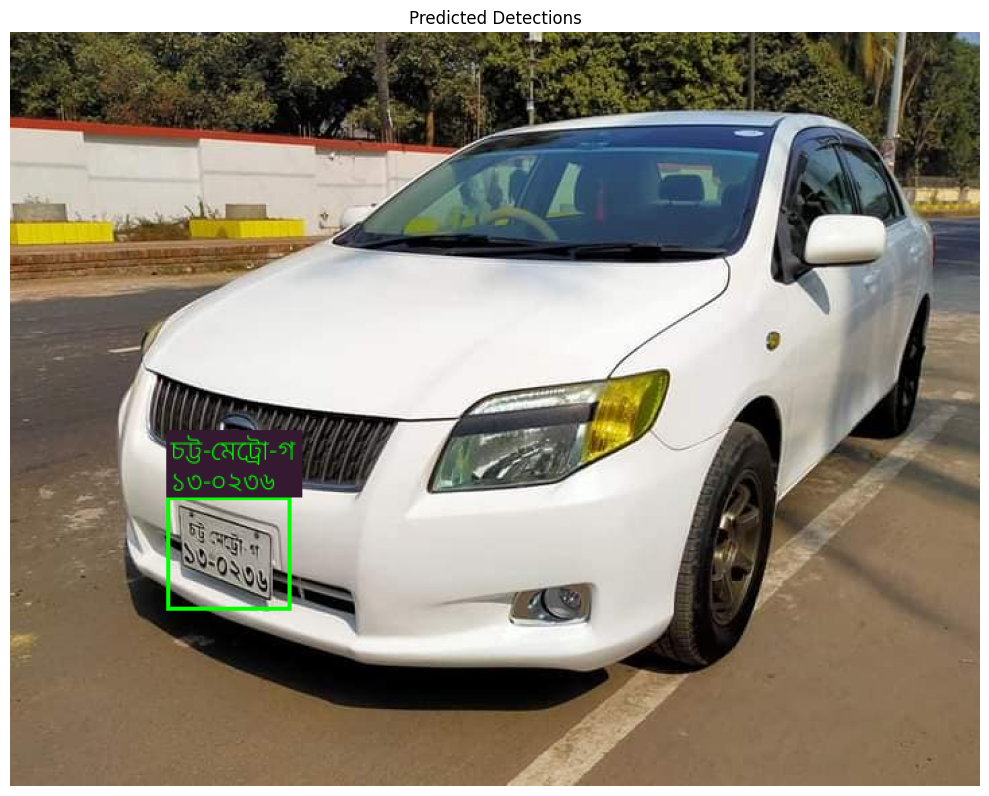


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-চ ১৯-৪০৬৭


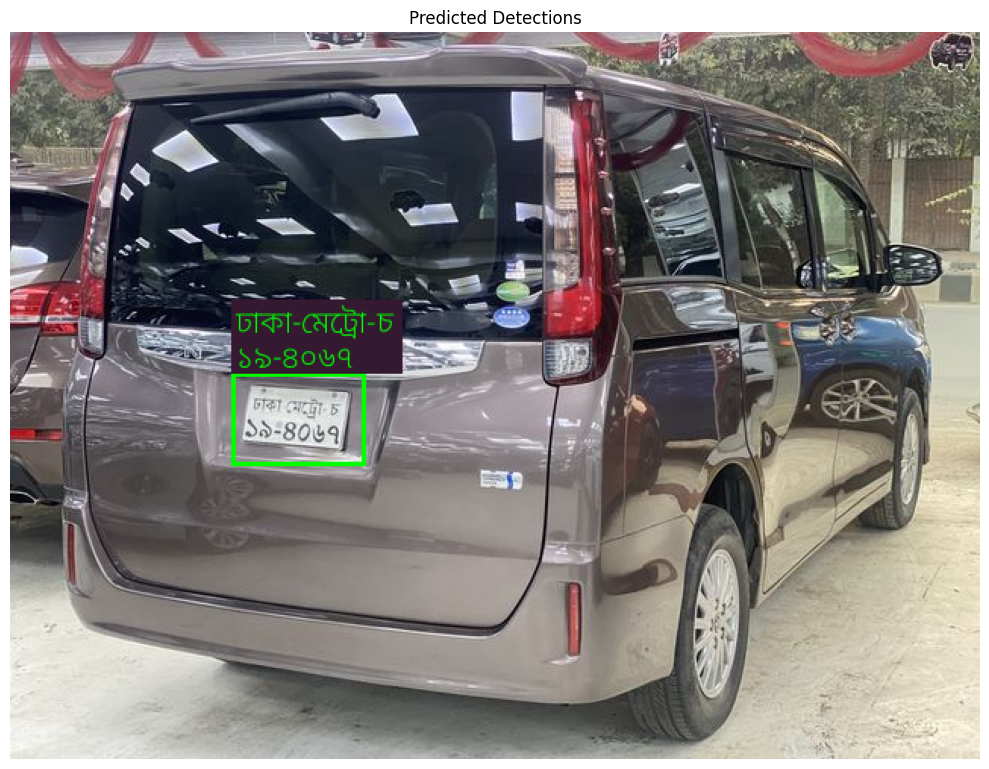


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-গ ১৩-৪৩৮৩


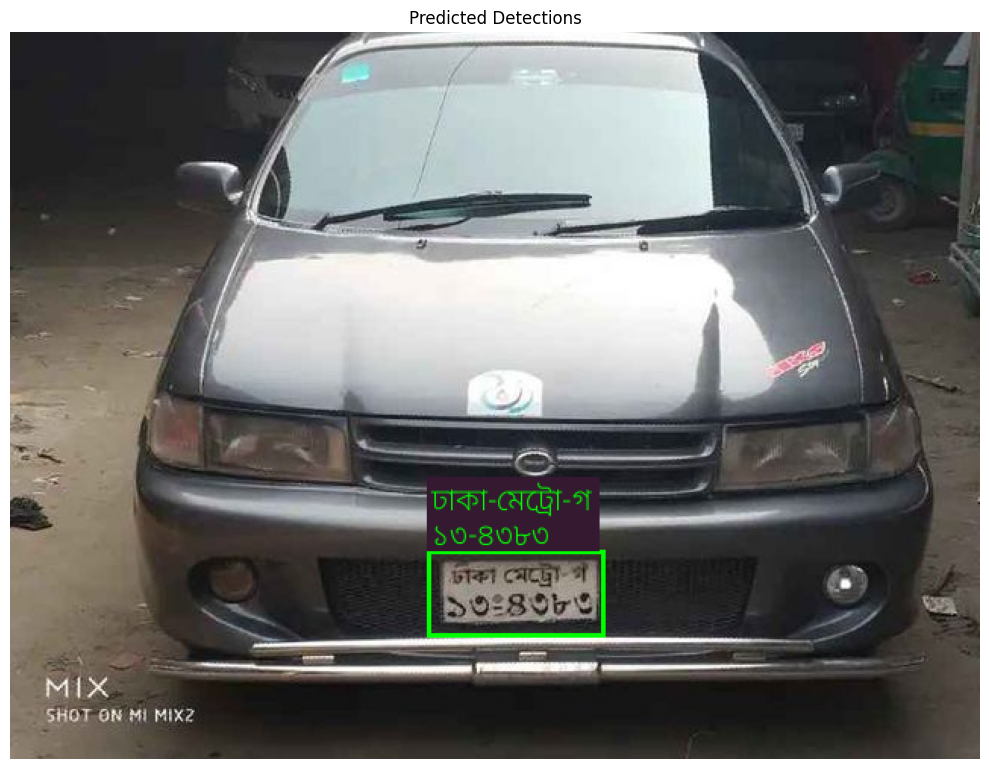


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-গ ২৯-৩৫৯২


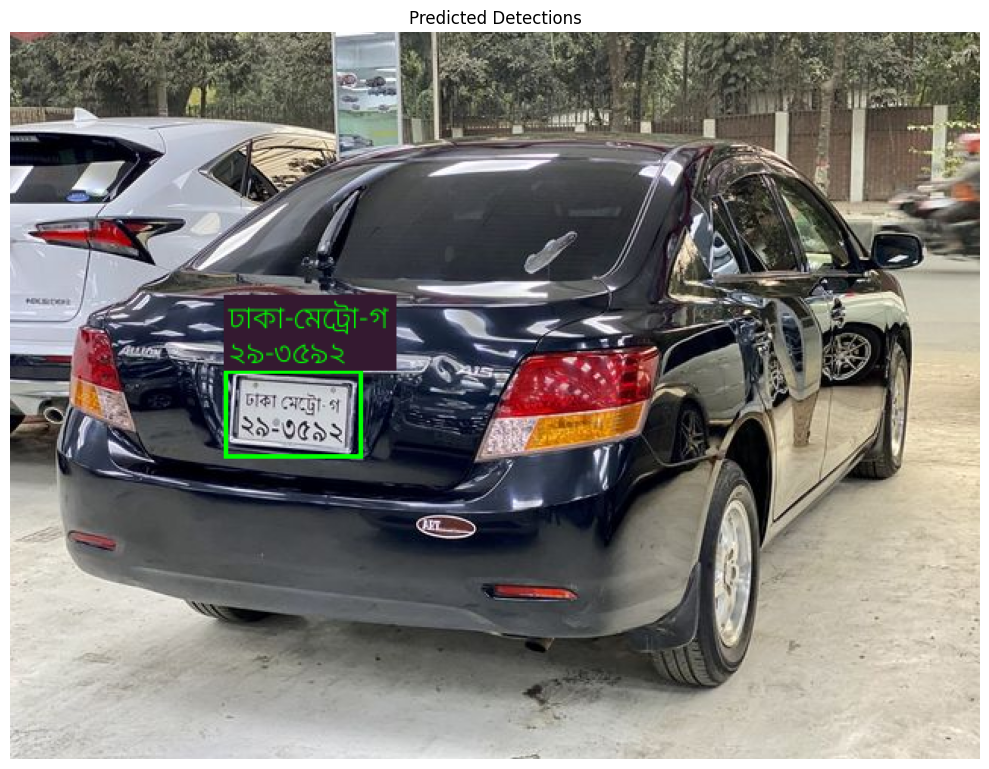


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-খ ১৩-০৮২৩


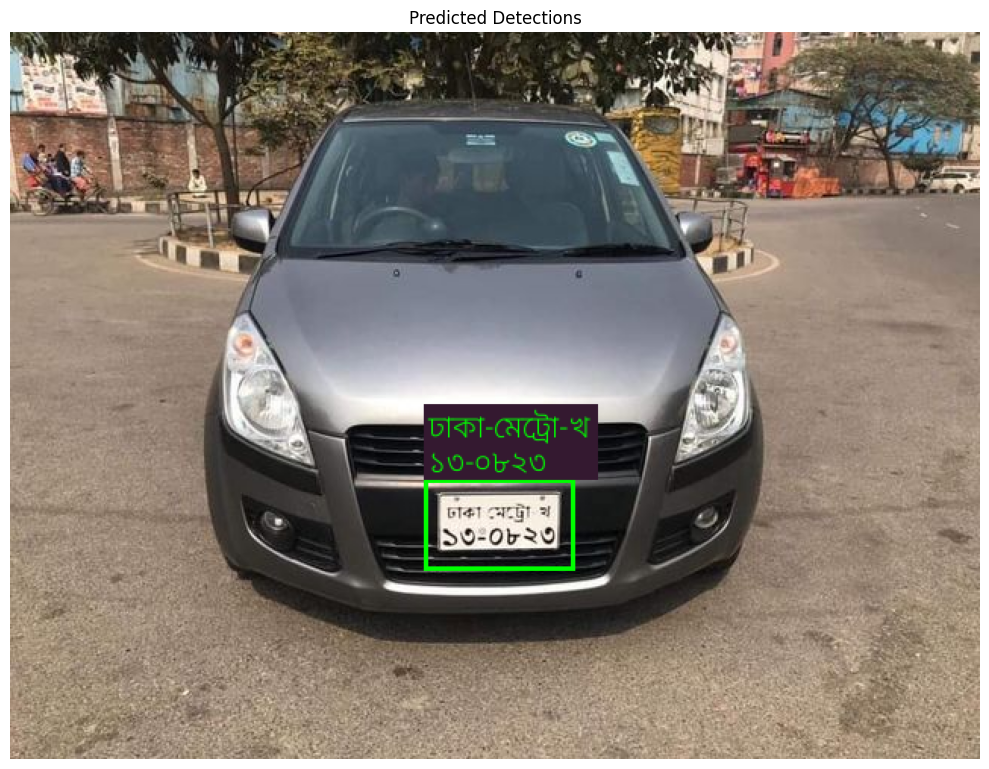


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: নওগাঁ-হ ১৩-১১৬৫


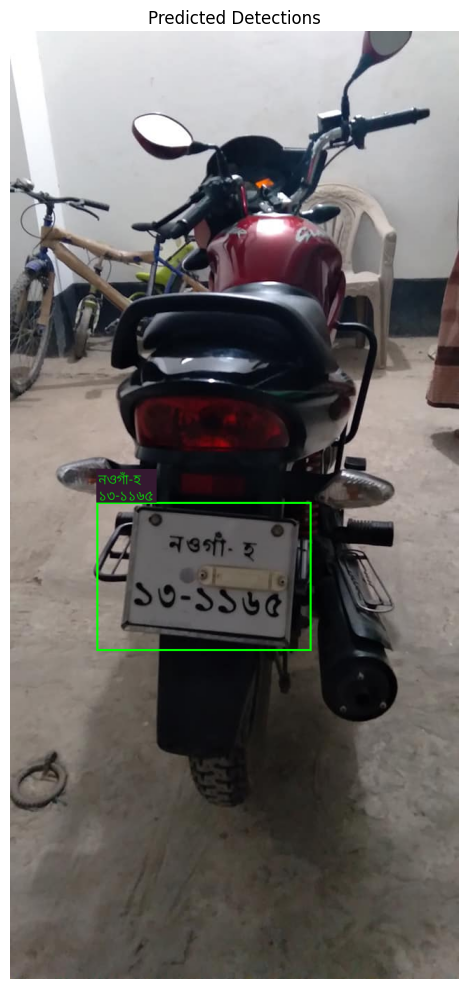


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-চ ১৩-৭০১০


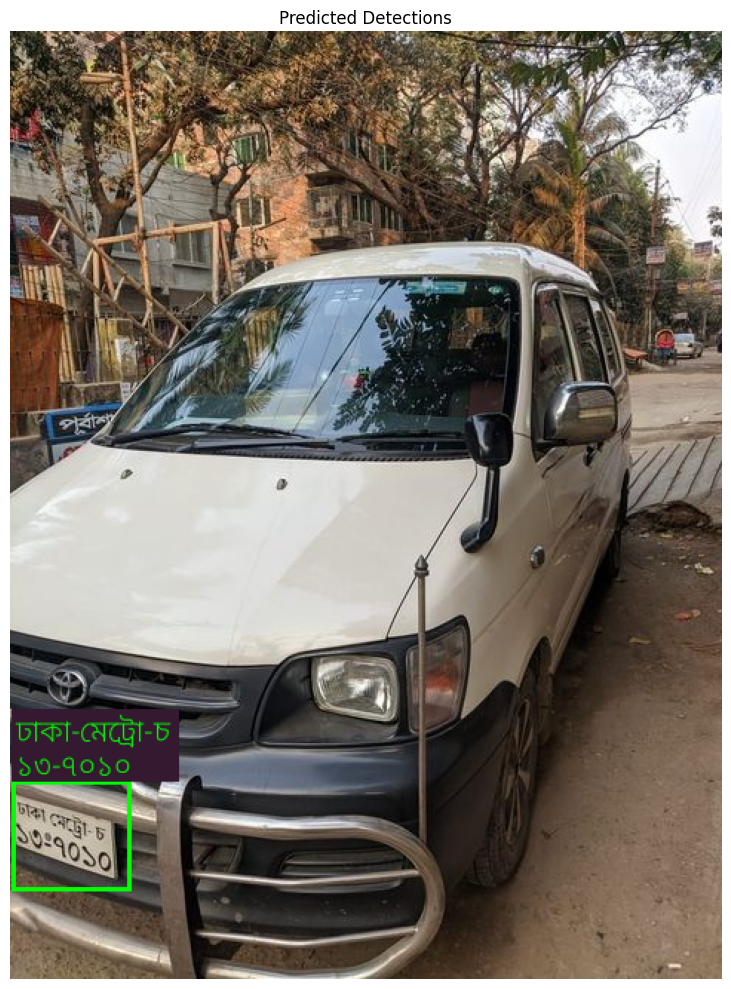


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-গ ১৭-১১৩৩


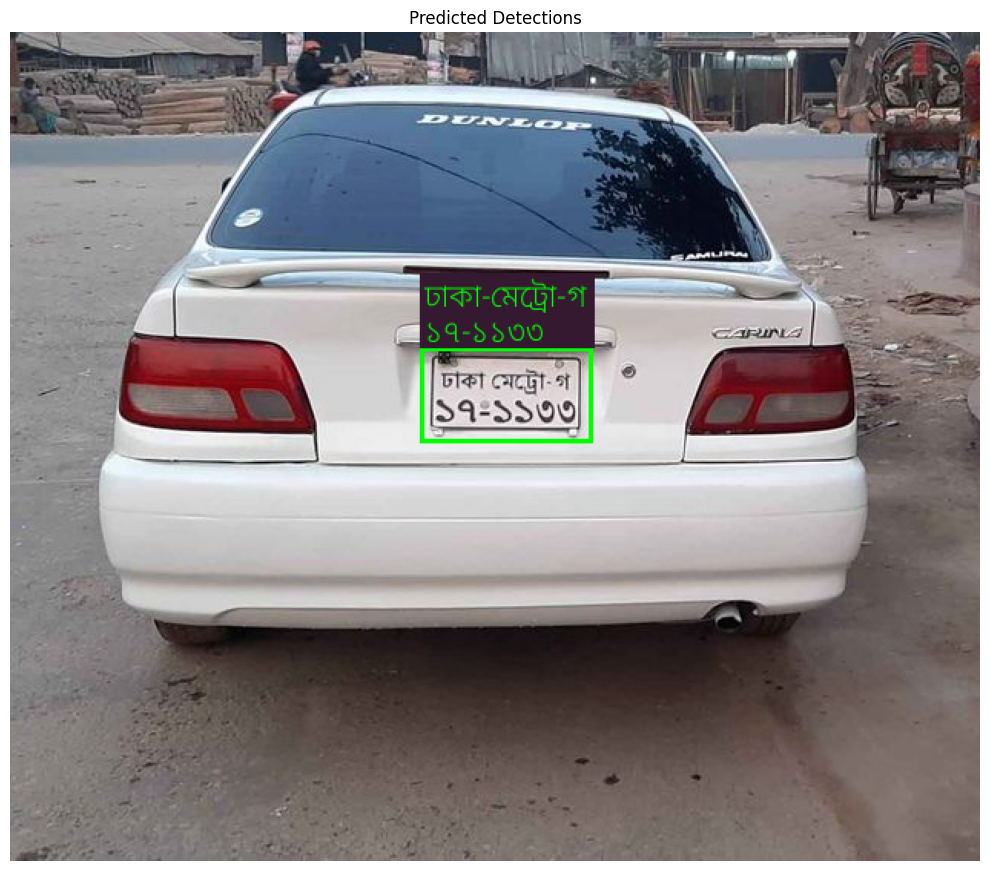


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: সিলেট-হ ১৪-৬২৯২


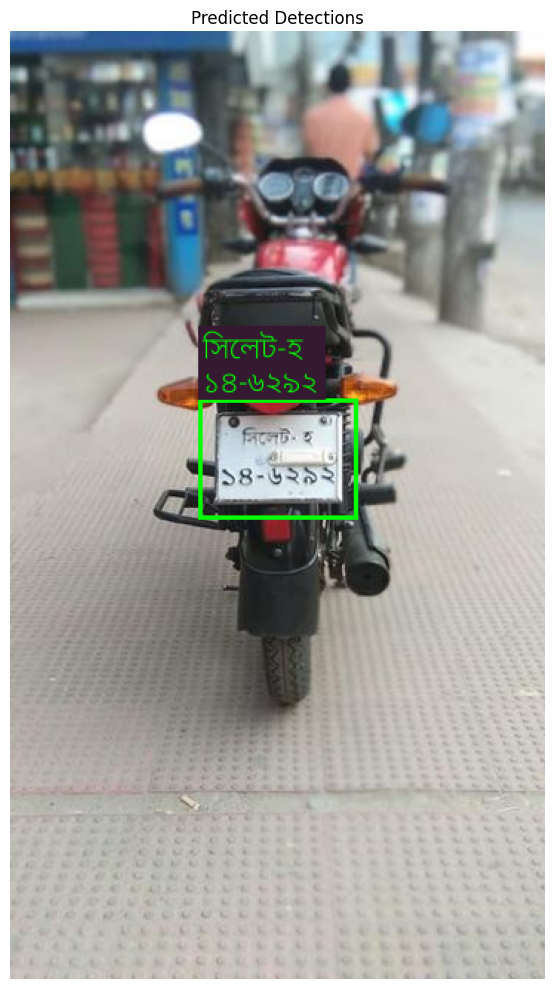


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-গ ২৫-৬১৯৮


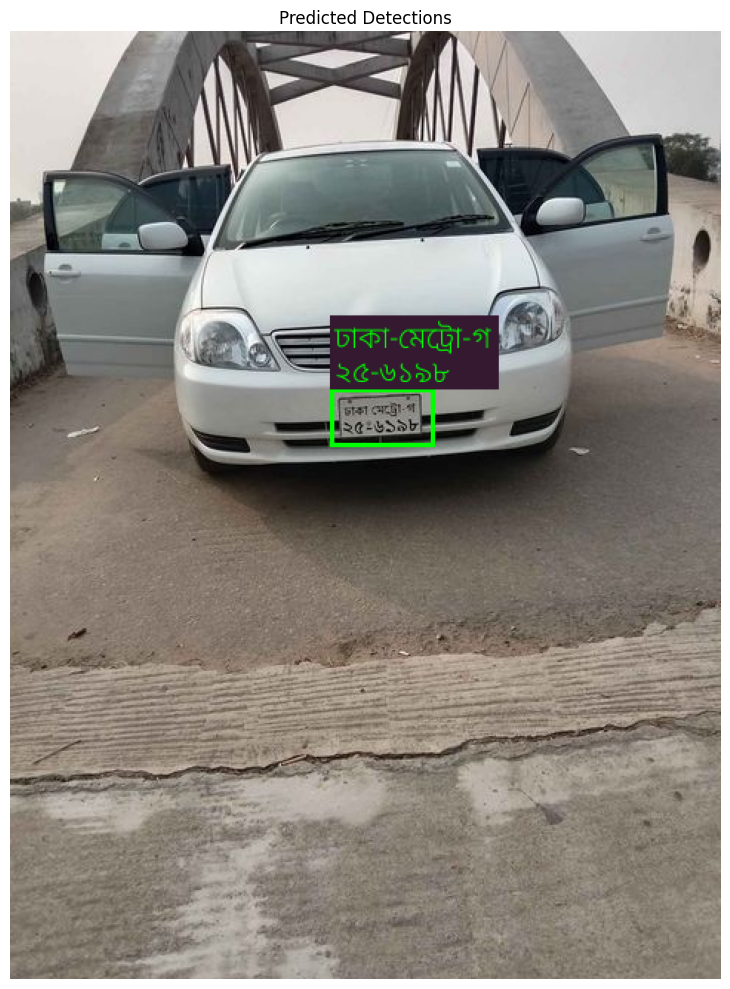


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: খুলনা-মেট্রো-হ ১৩-৩৫৫৩


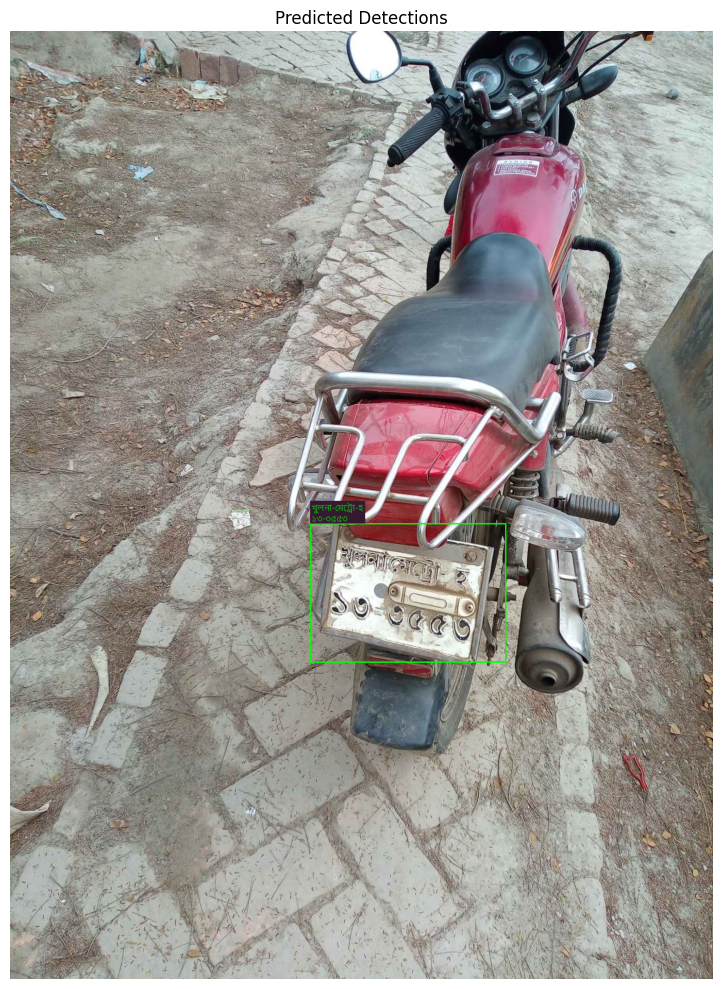


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-গ ১২-৭৩৮৪


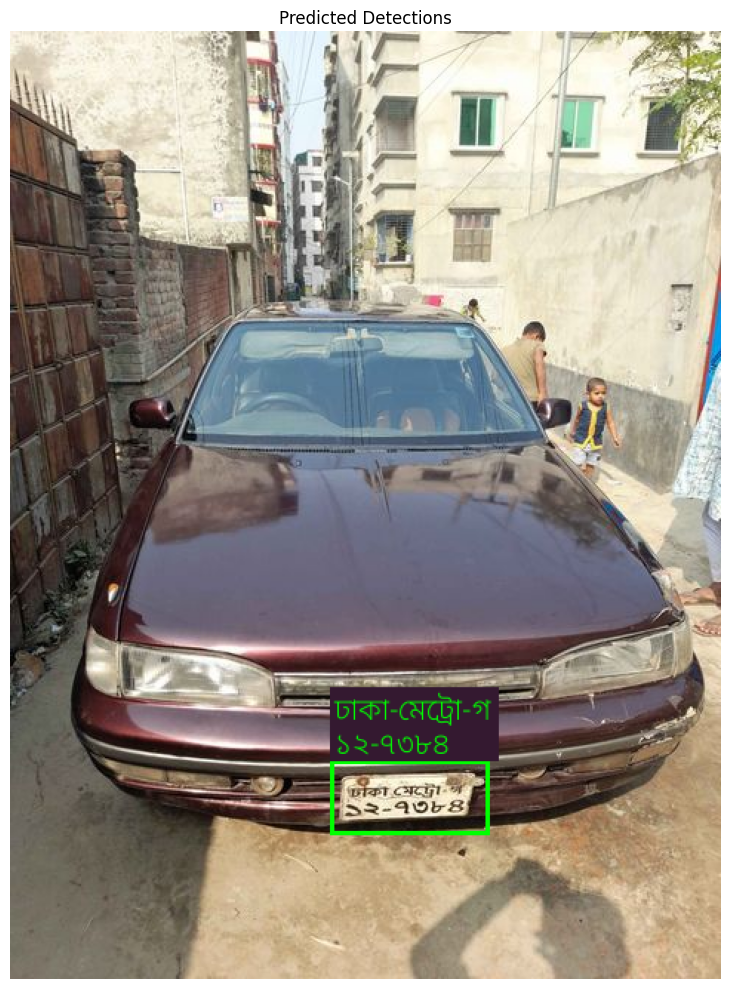


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-গ ১২-৭৩৩৩


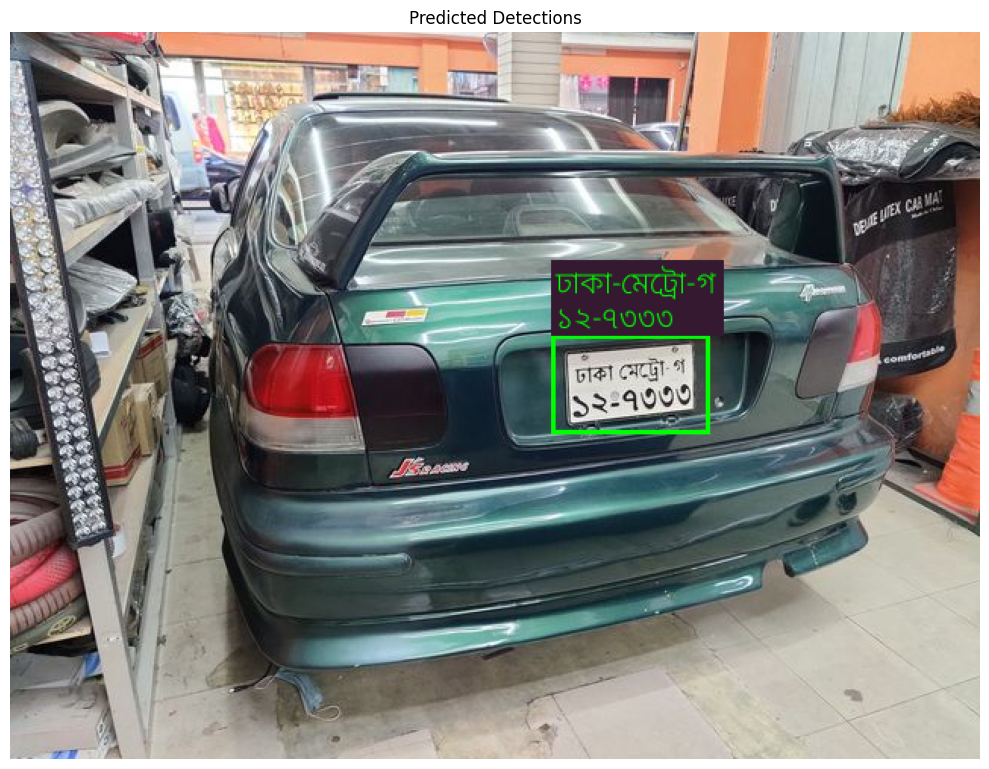


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-ল ৪১-৯০২৯


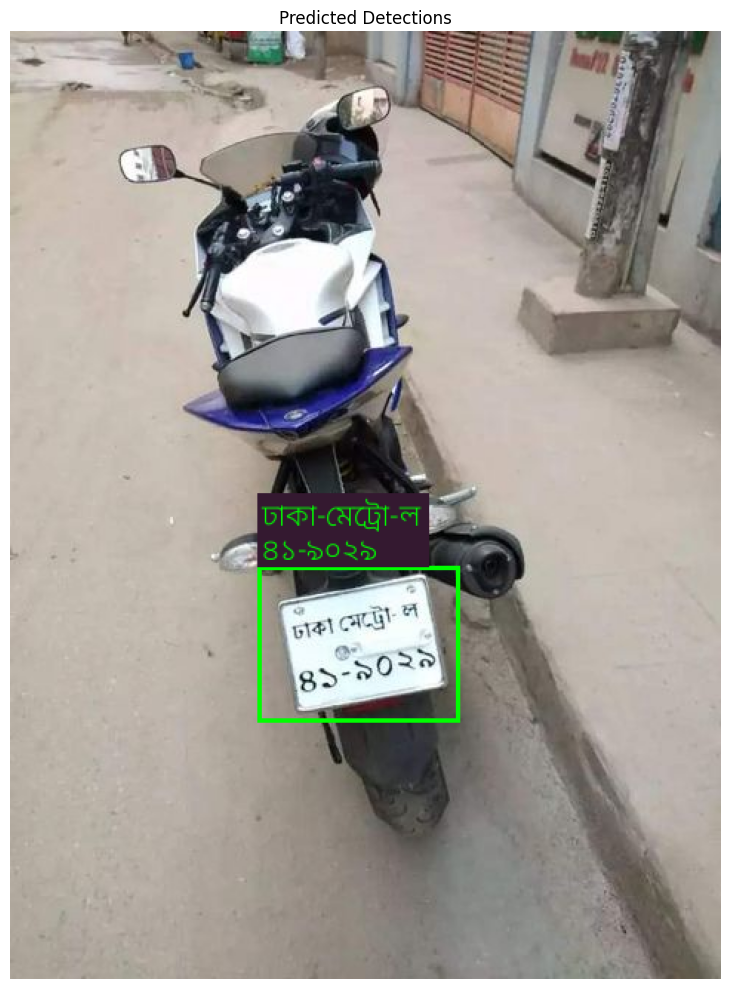


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো ২৩-৪৮০৪


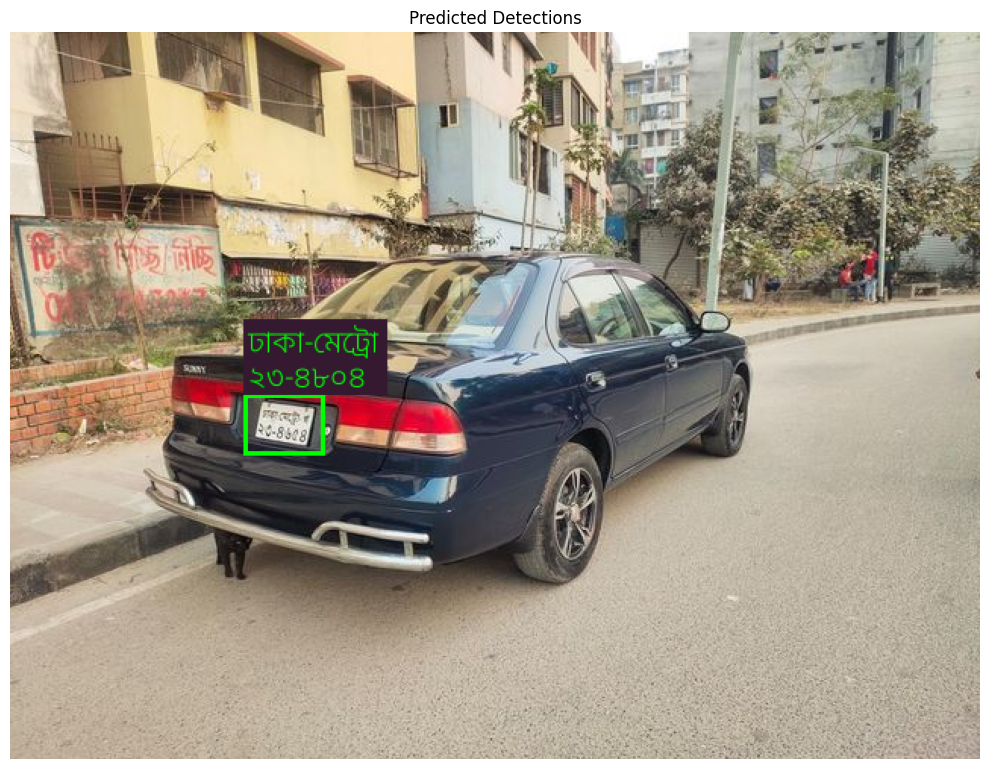


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-চ ১১-০৭৪০


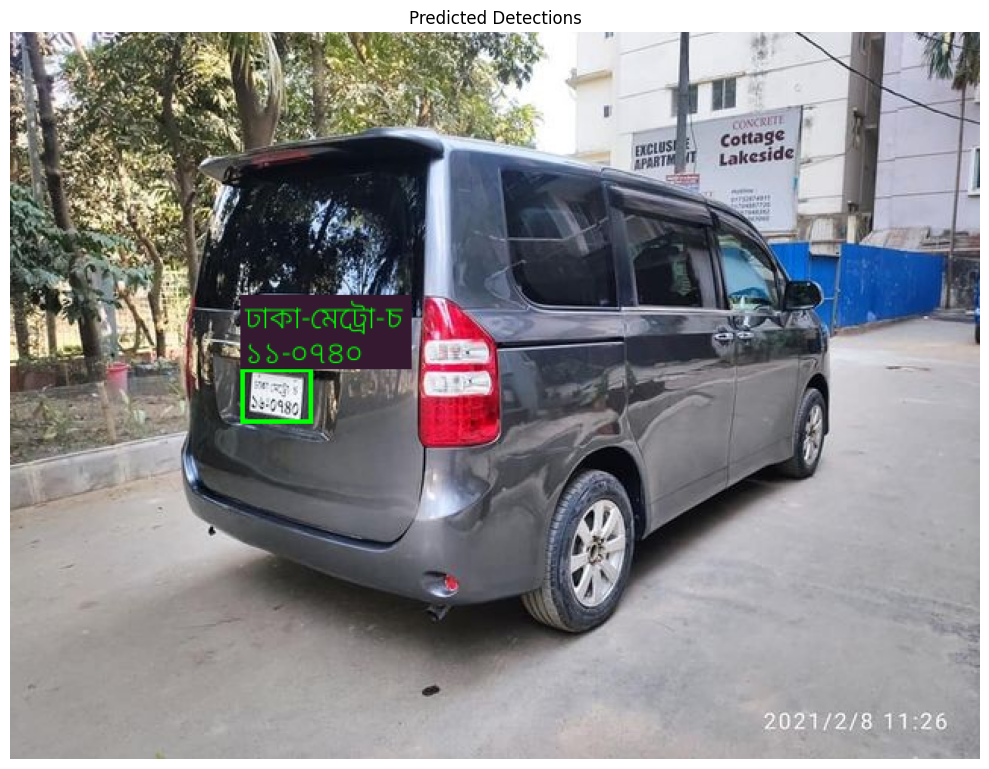


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: গাইবান্ধা-ল ১১-৩৮৭১


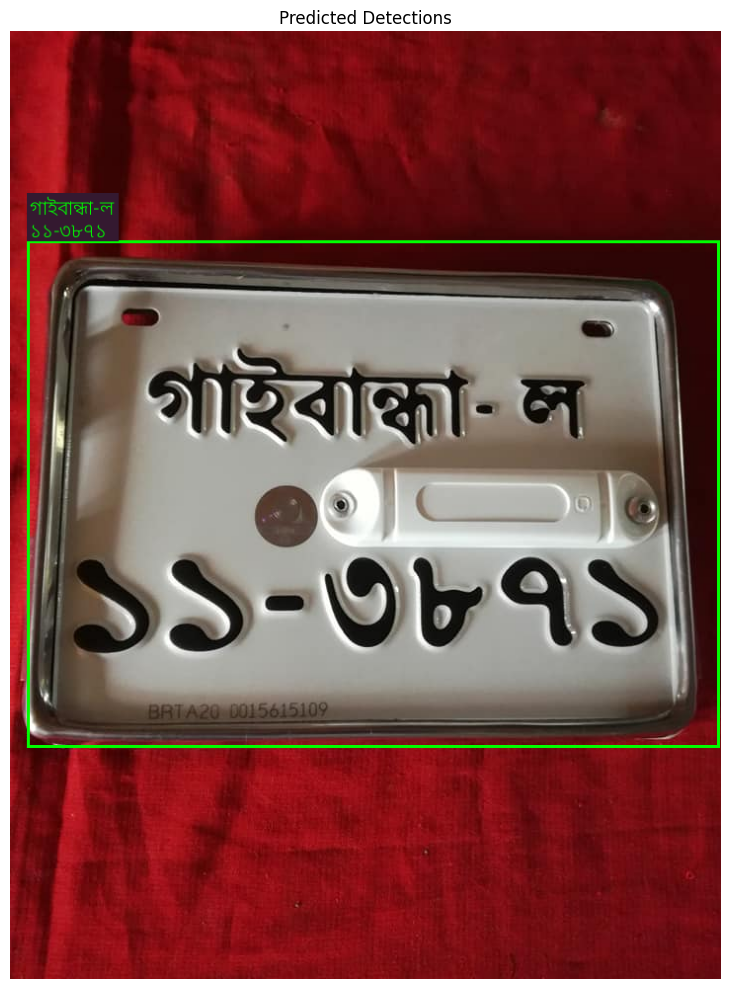


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো ৭১-১৩৫৮


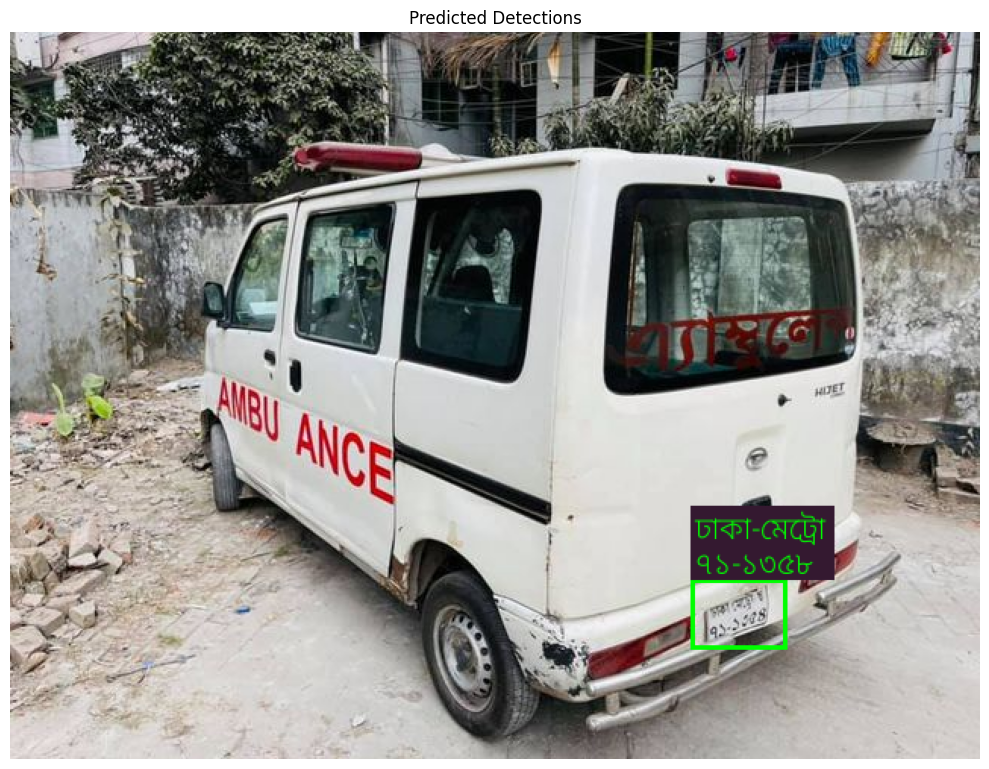


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: সিলেট-ল ১২-০৩৪০


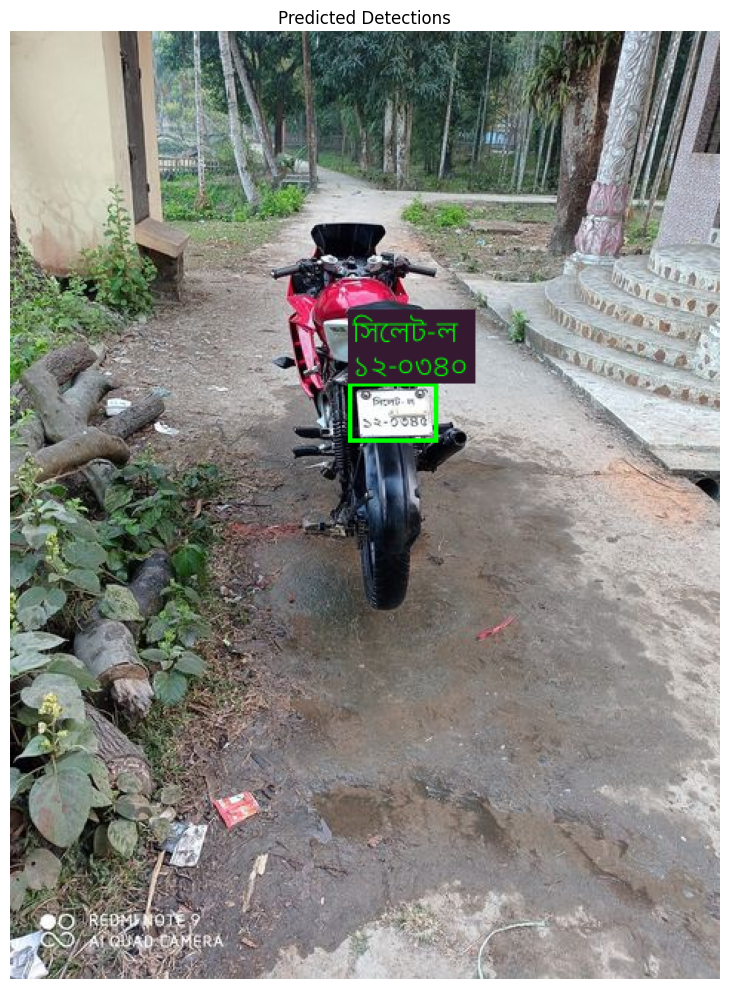


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: মানিকগঞ্জ-ল ১১-৪৯৯৪


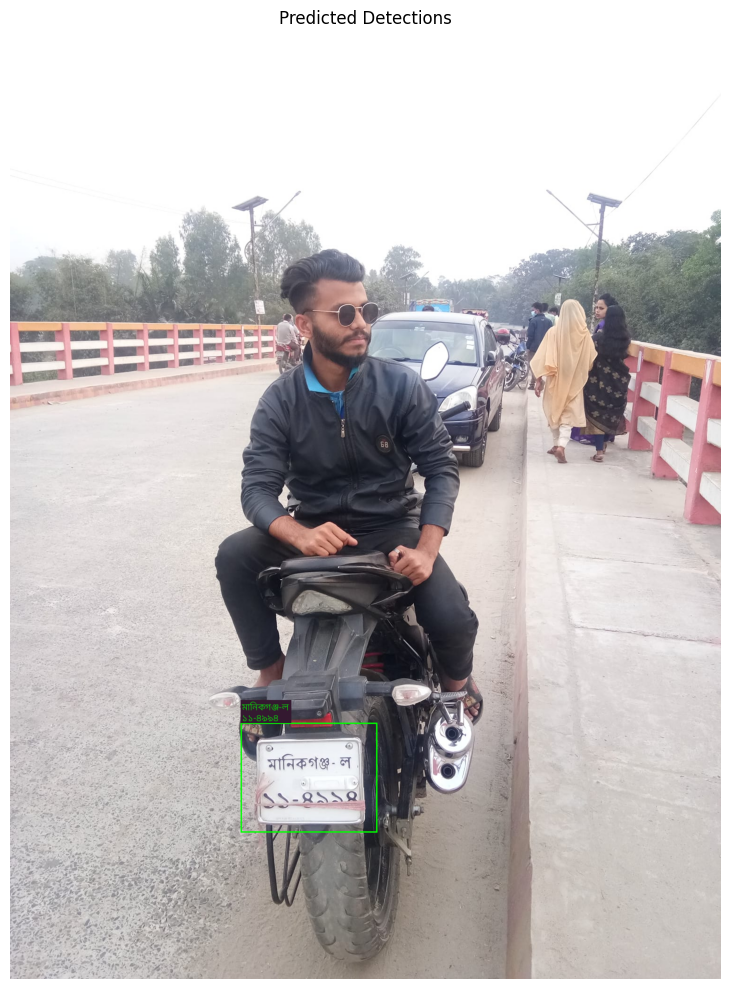


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: যশোর-হ ১৮-৪০৪২


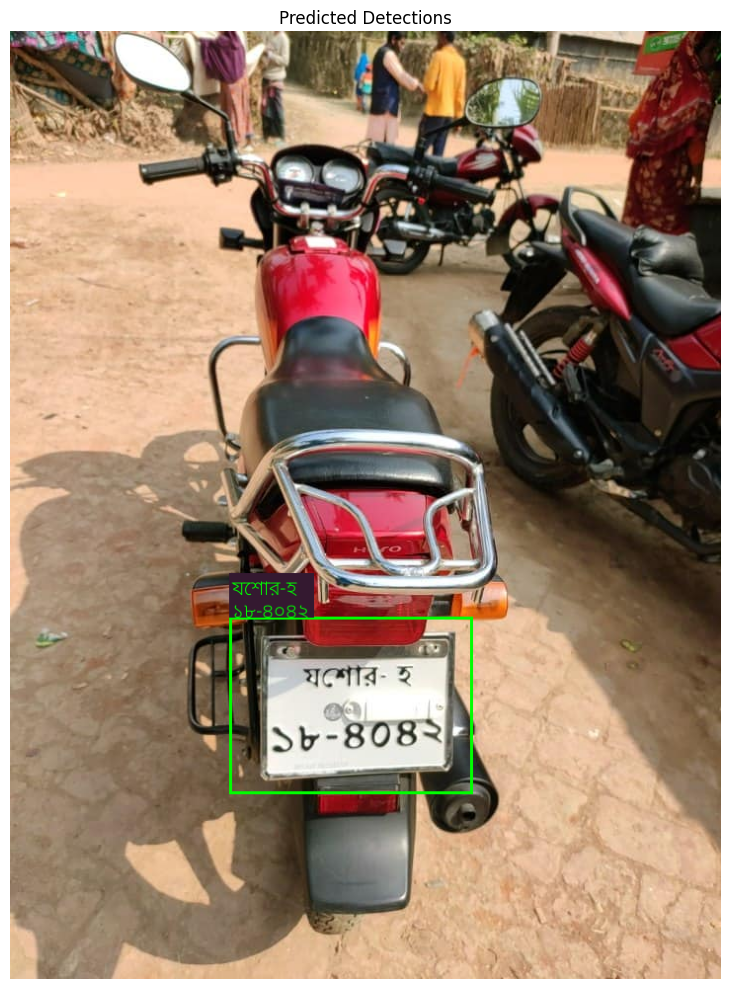


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ল ১১-০৮০১


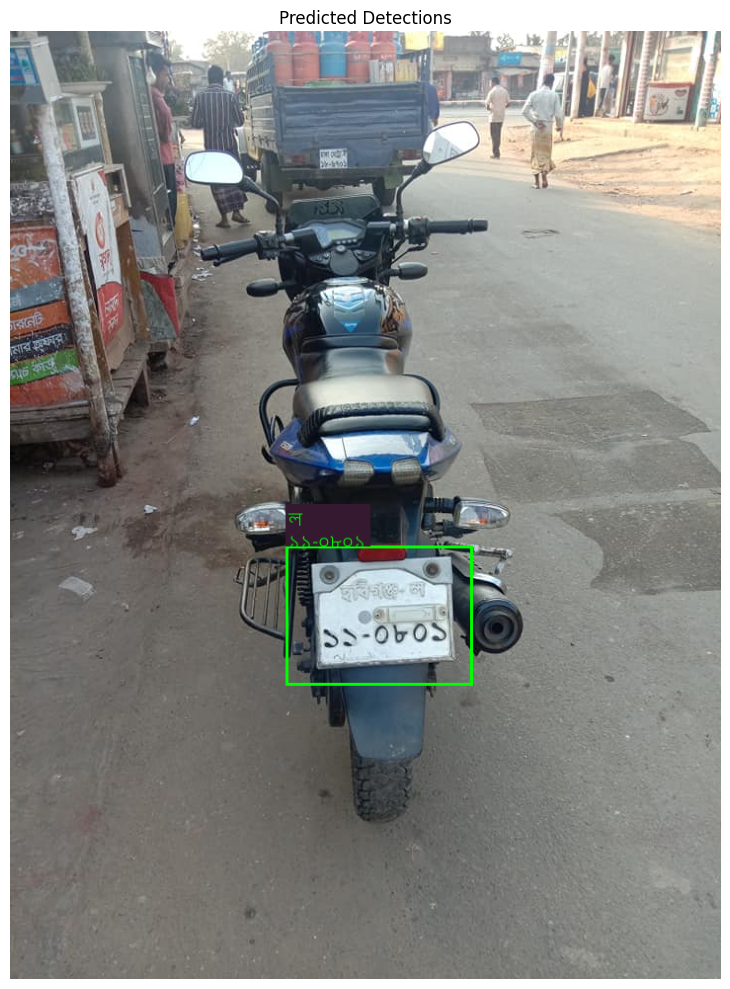


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: পিরোজপুর-ল ১১-১০৫৫


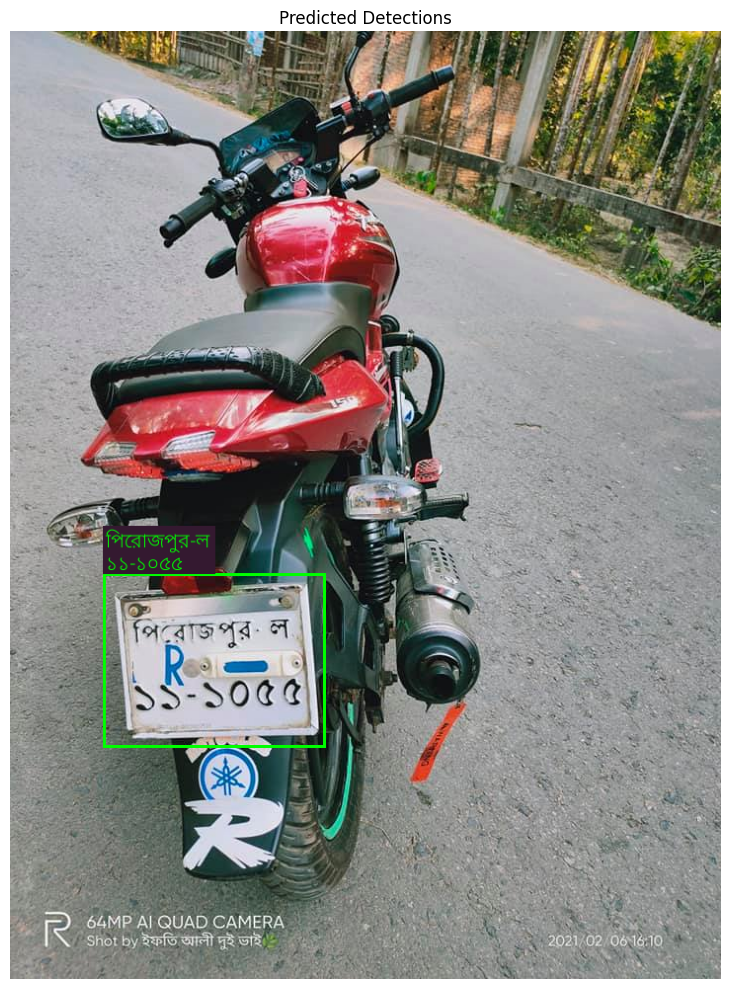


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: টাঙ্গাইল-ল ১২-২৩৬২


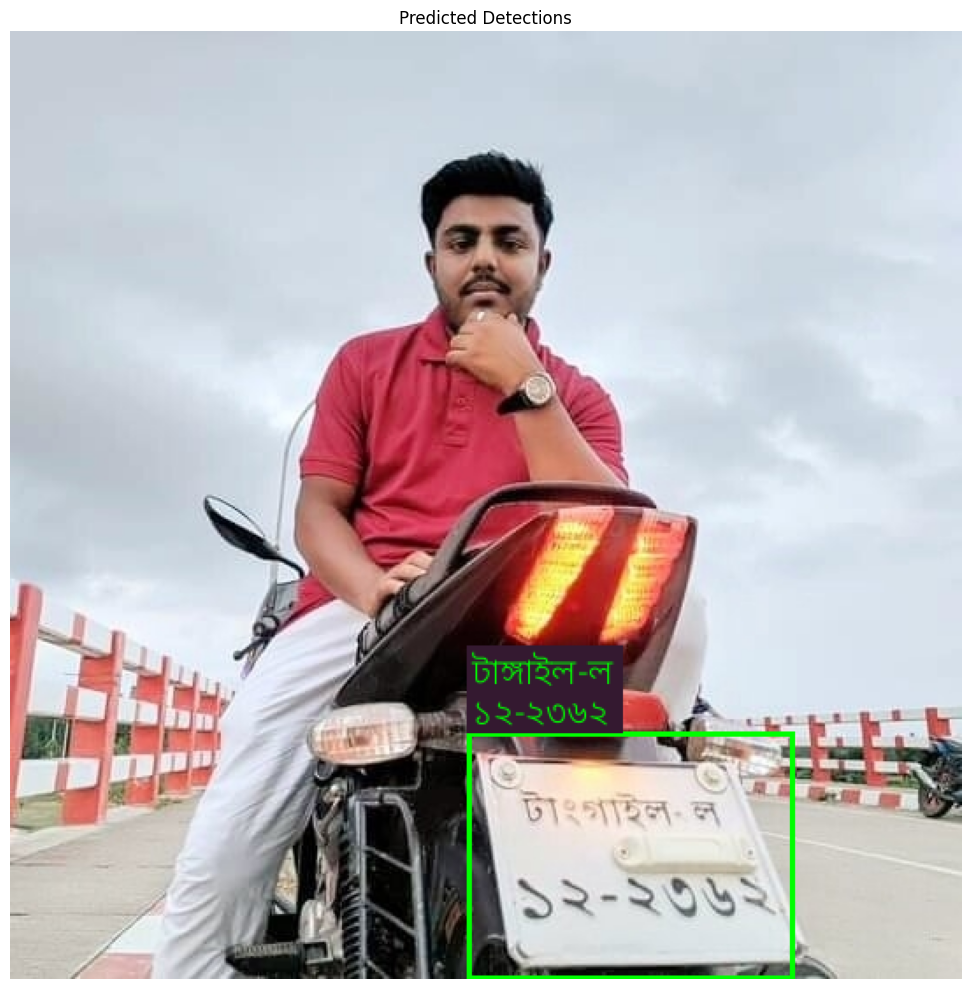


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: খুলনা-মেট্রো-হ ১২-৫৪৭৫


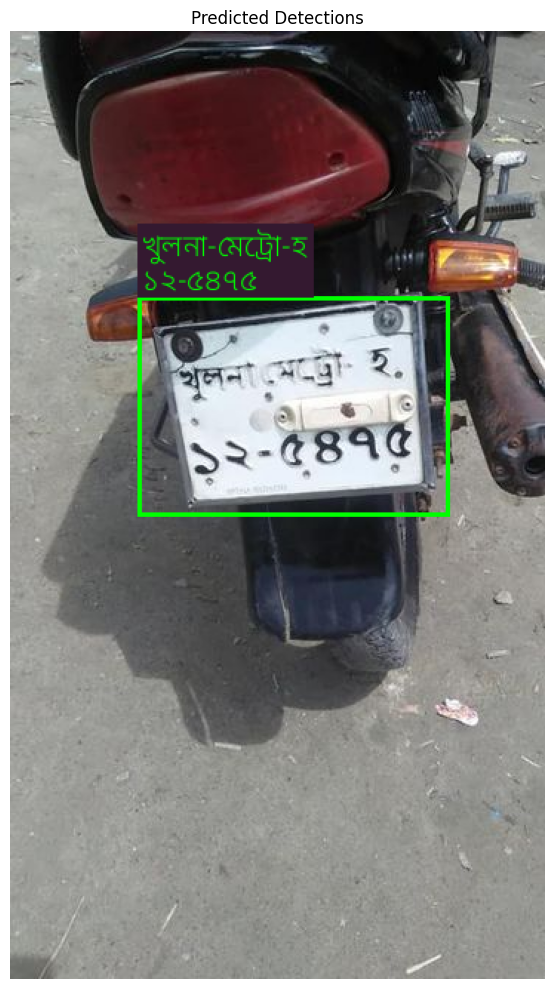


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-গ ৩৩-৭৩৪৬


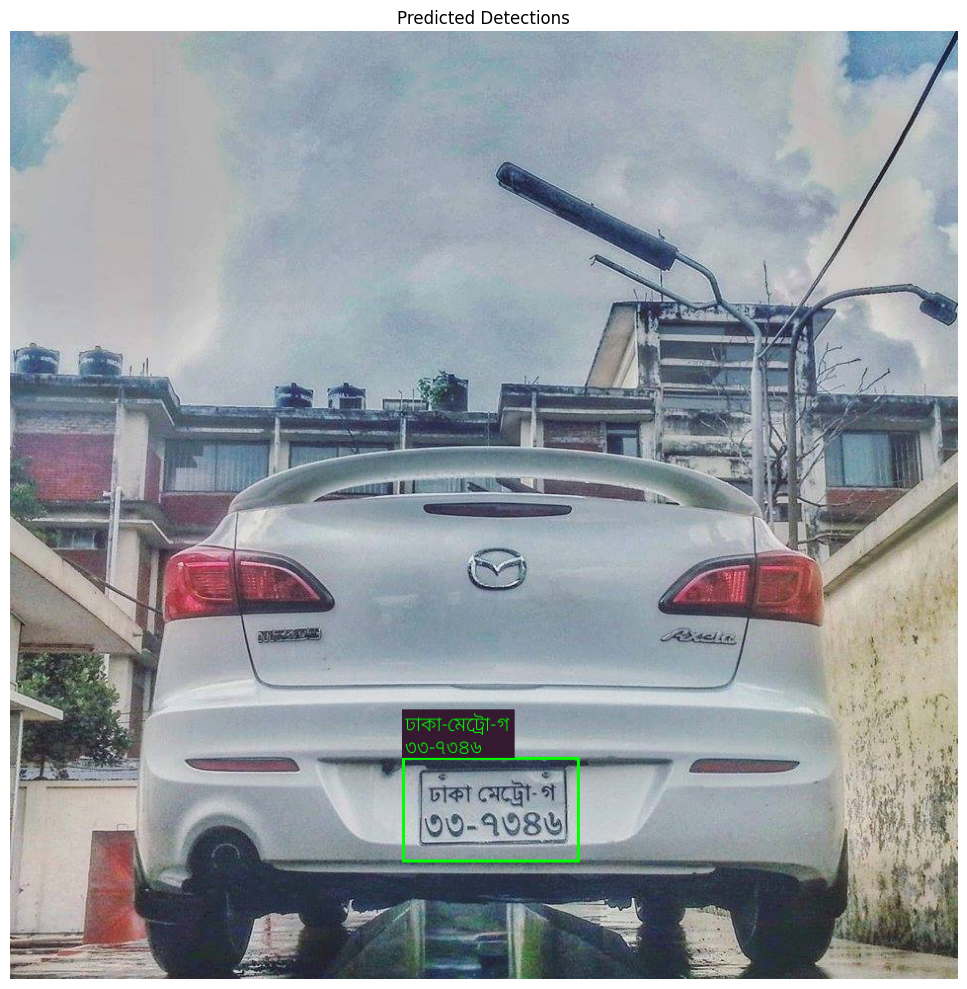


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: বান্দরবান-হ ১১-১১৪৮


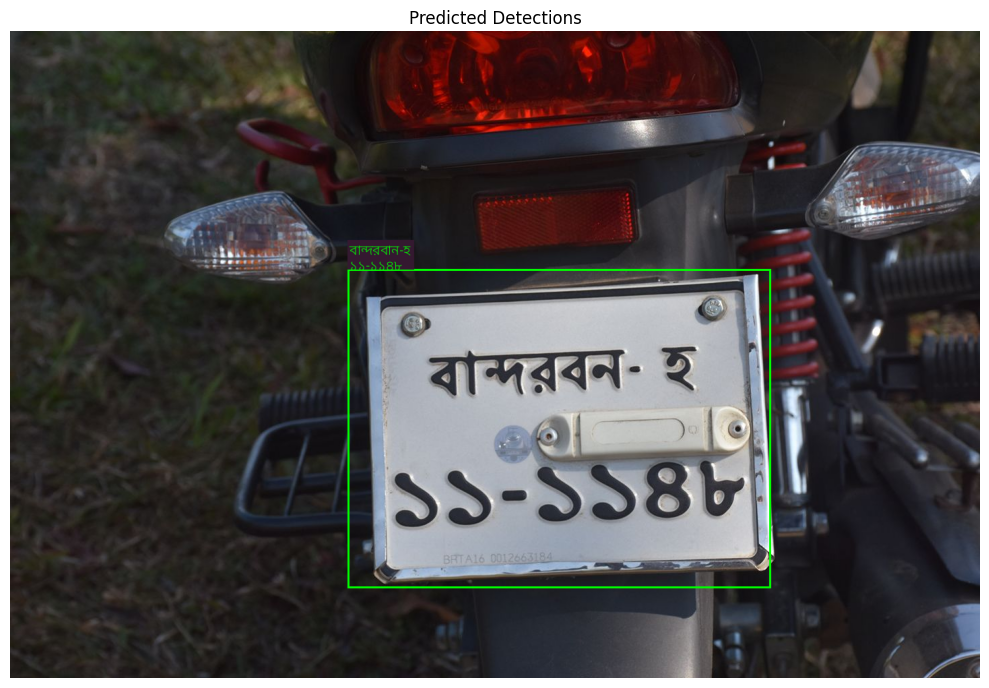


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-ঘ ১৫-৫৫২০


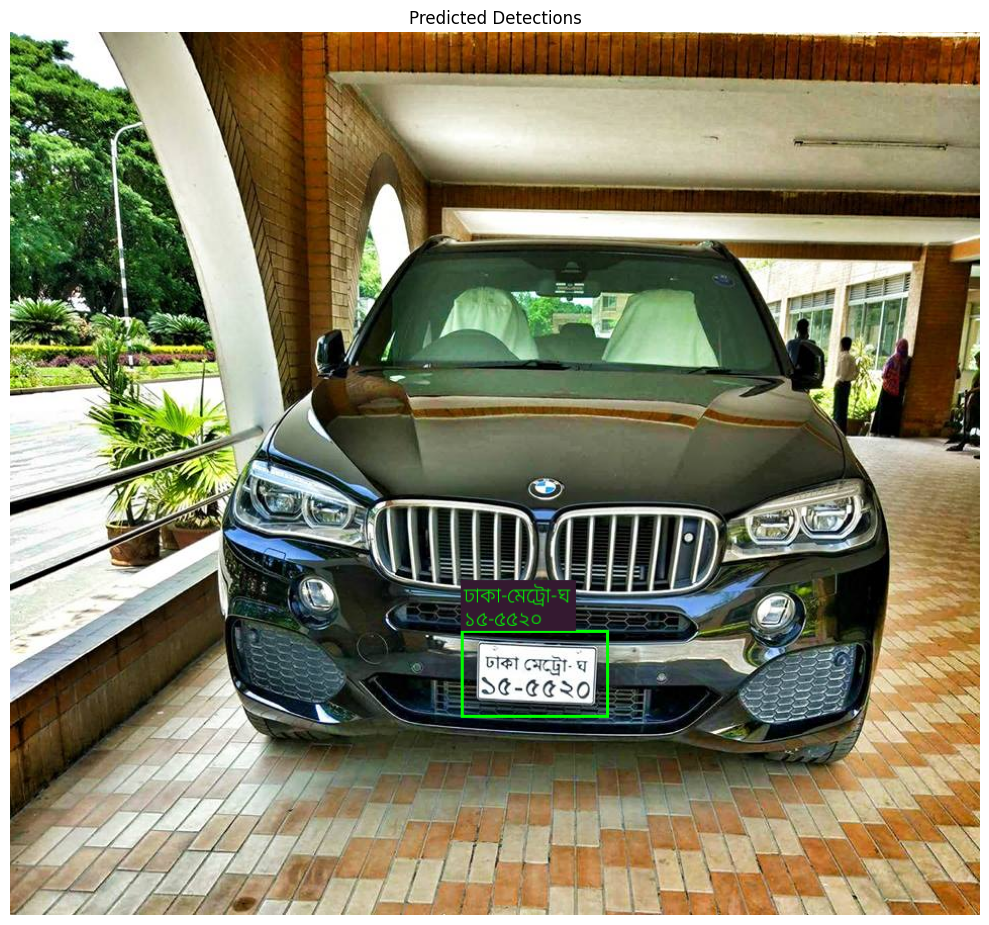


____________________________________________________________
Processing image for number plate detection...

Detected Plate Text: ঢাকা-মেট্রো-ড ১৪-০০৮২


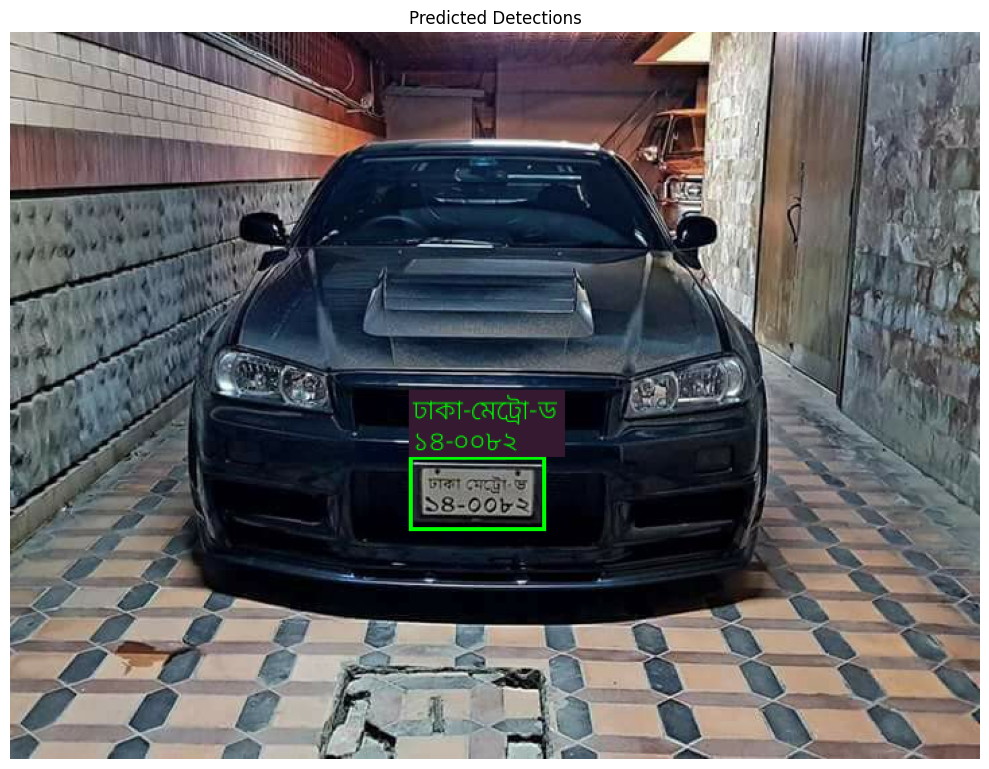

In [16]:
folder = "./custom-test-img"
folder = "./dataset/img-to-numplate/test/images"
max_files = 30  # <<< set your limit here
count = 0

for filename in os.listdir(folder):
    if count >= max_files:
        break

    if filename.lower().endswith((".jpg", ".jpeg", ".png")):
        path = os.path.join(folder, filename)
        image = cv2.imread(path)
        complete_numplate_detection(image)
        count += 1